In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math

## EA614 - Análise de Sinais

### Exemplo: análise da transformada de Fourier de um pulso retangular

**Objetivo:** perceber a relação entre a largura do pulso e a extensão do espectro em frequência

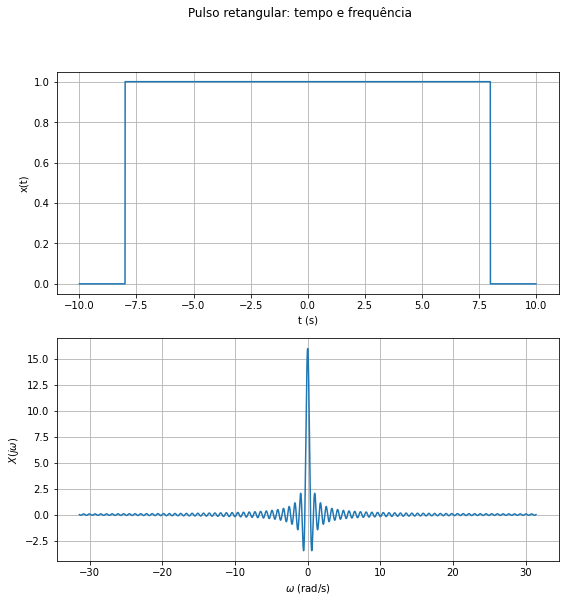

In [2]:
#eixo do tempo
t = np.linspace(-10,10,10000)

""" Parâmetros do pulso retangular: amplitude e largura """
amp = 1
tau = 16

#pulso retangular no tempo
xret = np.zeros((t.size,))
xret[abs(t) <= tau/2] = amp

#eixo das freqs
w = np.linspace(-10*math.pi,10*math.pi,10000)
#transformada de Fourier do pulso retangular
Xjw = amp*tau*np.sinc(w*tau/(2*math.pi))


fig,(ax1, ax2) = plt.subplots(2, 1, figsize=(9,9))
fig.suptitle('Pulso retangular: tempo e frequência')

ax1.plot(t, xret)
ax1.set_ylabel('x(t)')
ax1.set_xlabel('t (s)')
ax1.grid(True)

ax2.plot(w, Xjw)
ax2.set_xlabel('$\omega$ (rad/s)')
ax2.set_ylabel('$X(j\omega)$')
ax2.grid(True)

plt.show()

In [3]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

t = np.linspace(-12,12,10000)
xret = np.zeros((t.size,))

#faixa de valores de tau (largura do pulso)
faixa = np.arange(2,40,2)

# Cria a figura
fig = make_subplots(rows=2, cols=1,row_heights=[9,9],column_widths=[16])

# Add traces, one for each slider step
for step in faixa:
    yy = xret
    yy[abs(t) <= step/2] = amp
    fig.add_trace(
        go.Scatter(
            visible=False,
            line=dict(color='blue', width=2),
            name="Tempo",
            x=t,
            y=yy,
        ),
        row=1, col=1
    )
    fig.add_trace(
        go.Scatter(
            visible=False,
            line=dict(color='red', width=2),
            name="Frequência",
            #eixo de frequências
            x=np.linspace(-10*math.pi,10*math.pi,10000),
            #espectro
            y=amp*step*np.sinc(w*step/(2*math.pi))),
        row=2, col=1
    )

# Make 10th trace visible
fig.data[10].visible = True
fig.data[11].visible = True

# Create and add slider
steps = []
for i in np.arange(0,faixa.size,2):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)}],  # layout attribute
        label = str(i+2)
    )
    step["args"][0]["visible"][i] = True  # Toggle i'th trace to "visible"
    step["args"][0]["visible"][i+1] = True  # Toggle (i+1)'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=10,
    currentvalue={"prefix": "Tau = "},
    #pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders,
    title_text="Pulso retangular: forma de onda e espectro")

fig.show()